INSTALL ALBUMENTATIONS (TIVE QUE USAR ESSES ARGUMENTOS POR JÁ TER OPENCV INSTALADO NO SISTEMA)

In [ ]:
!pip install -q -U albumentations --no-binary qudida,albumentations

In [1]:
import cv2
import albumentations as A
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import csv
import random
#from google.colab.patches import cv2_imshow

import os 
import json 


OPEN CSV COM ANOTAÇÕES DE BOUNDING BOXES

In [3]:
images    = []
trainRows = []
allRows   = []

with open('/content/drive/MyDrive/CSVs/Modelo5.csv', 'r') as f:
    reader = csv.reader(f)
    for row in reader:
        
        allRows.append(row)
        checkTrain = row[0]

        if checkTrain == 'TRAIN':
            trainRows.append(row)

        if not images:
            if checkTrain == 'TRAIN':
                images.append(row[1])

        elif row[1] != images[-1] and checkTrain == 'TRAIN':
            images.append(row[1])


FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/CSVs/Modelo5.csv'

In [2]:
def draw_labels(labels,img,show = False):
    
    labels = np.array(labels).astype(int) 
    img = np.array(img).astype(np.uint8)  
    h,w,c  = img.shape
    for bb in labels:
        if max(bb)<=1:
            y = (bb[[1,3,5,7]]*h).astype(int)
            x = (bb[[0,2,4,6]]*w).astype(int)
            cv2.rectangle(img,(x[0],y[0]),(x[1],y[2]),(0,255,0),2)
        #if bb.shape[0] == 4:
        #    bb_int = bb.astype(int)
        #    cv2.rectangle(img,(bb_int[0],bb_int[1]),(bb_int[2],bb_int[3]),(0,255,0),2)
        else:
            y = (bb[[1,3]]).astype(int)
            x = (bb[[0,2]]).astype(int)
            cv2.rectangle(img,(x[0],y[0]),(x[1],y[1]),(0,255,0),2)
        
    if show:
        plt.figure(figsize = (15,30))
        plt.imshow(img)
    
    return img

In [3]:

def read_json(path):
    f = open(path)
    data = json.load(f)
    f.close()
    return data


def parse_labelme(data,img):
    h,w,c = img.shape
    points = []
    
    def clip(value,top):
        return min(max(value,0),top)
    
    for shapes in data["shapes"]:
        x0,y0 = np.array(shapes["points"])[0]
        x1,y1 = np.array(shapes["points"])[1]

        if x0>x1:
            x1,x0 = x0,x1 

        if y0>y1:
            y1,y0 = y0,y1 
            
        if x1 == x0 or y1 == y0:
            continue

        x1,x0,y1,y0 = clip(x1,w), clip(x0,w), clip(y1,h), clip(y0,h)
        points.append([int(x0), int(y0), int(x1), int(y1)])
    
    return np.array(points)

def labelme_to_tf(data,img):
    h,w,c = img.shape
    points = []
    
    def clip(value):
        return min(max(value,0),1)
    
    for shapes in data["shapes"]:
        x0,y0 = np.array(shapes["points"])[0]
        x1,y1 = np.array(shapes["points"])[1]
        
        if x0>x1:
            x1,x0 = x0,x1 
        
        if y0>y1:
            y1,y0 = y0,y1 
        
        x1,x0,y1,y0 = clip(x1),clip(x0),clip(y1),clip(y0)
        
        if x1 == x0 or y1 == y0:
            continue

        points.append([x0/w, y0/h,  x1/w, y0/h, x1/w, y1/h, x0/w, y1/h])
       
    
    return np.array(points)
    
    
def proportion_to_pixel(img,labels):
    h,w,c  = img.shape
    bb = []
    for proportional_bb in labels:
        #pix_bb = proportional_bb.copy()
        
        y = (proportional_bb[[1,3,5,7]]*h).astype(int)
        x = (proportional_bb[[0,2,4,6]]*w).astype(int)
        x_min, y_min, x_max, y_max = x[0],y[0],x[1],y[2]
        
        bb+=[[x_min, y_min, x_max, y_max]]
        
    return np.array(bb)
        
def pixel_to_proportion(img,labels):
    h,w,c  = img.shape
    bb = []
    for proportional_bb in labels:
        
        #pix_bb = proportional_bb.copy()
        #print("H",h,"W",w,"proportional_bb",proportional_bb)
        
        y = proportional_bb.astype(np.float32)[[0,2]]/h
        
        x = proportional_bb.astype(np.float32)[[0,2]]/w
        

        
        #print(x,y)
        
        x_min, y_min, x_max, y_max = x[0],y[0],x[1],y[1]
        
        if x_min == x_max or y_max == y_min:
            continue
        
        bb+=[[x_min, y_min, x_max, y_max]]
        
    return np.array(bb)
    




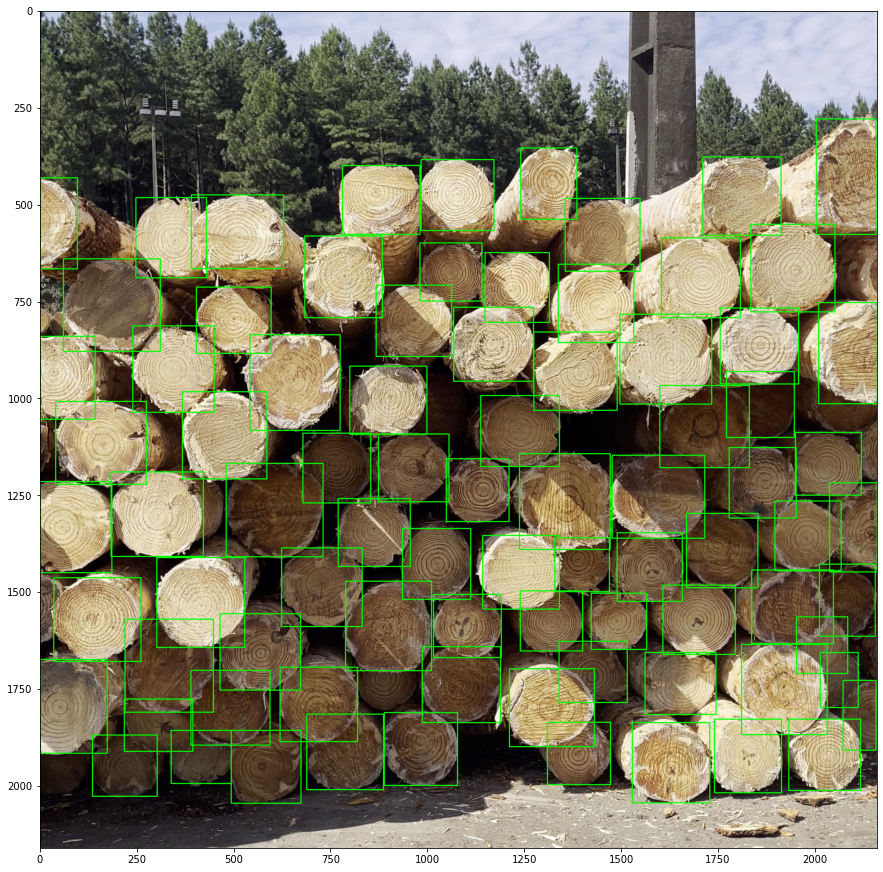

In [4]:
folder_path = "realCampo/"

files = os.listdir(folder_path)
k=0 
for file in files:
    k+=1
    if ".json" in file:
        
        img    = cv2.imread(folder_path+file.replace(".json",".jpg"))[:,:,::-1]
        data   = read_json(folder_path+file)
        labels = labelme_to_tf(data,img)
        bboxes = proportion_to_pixel(img,labels)
        draw_labels(bboxes,img)
        
        break
        
img    = cv2.imread("realCampo/6.jpg")[:,:,::-1]
data   = read_json("realCampo/6.json")
labels = parse_labelme(data,img)
bboxes = pixel_to_proportion(img,labels)

img_drawn = draw_labels(labels,img,True)

In [55]:
class Change:
    def __init__(self):

        self.input_transform = A.Compose([

        A.OneOf([
            
            A.Blur(blur_limit=20, p=0.99),
            
            A.Spatter(mean=0.65, 
                          std=0.5, 
                          gauss_sigma=2, 
                          cutout_threshold=0.68, 
                          intensity=0.6, 
                          mode='rain', 
                          always_apply=True, 
                          p=0.99)

            ], p=1)

        ],bbox_params=A.BboxParams(format='pascal_voc', label_fields=[]))

    def apply(self,img,bboxes):
        
        return self.input_transform(image=img, bboxes=bboxes)


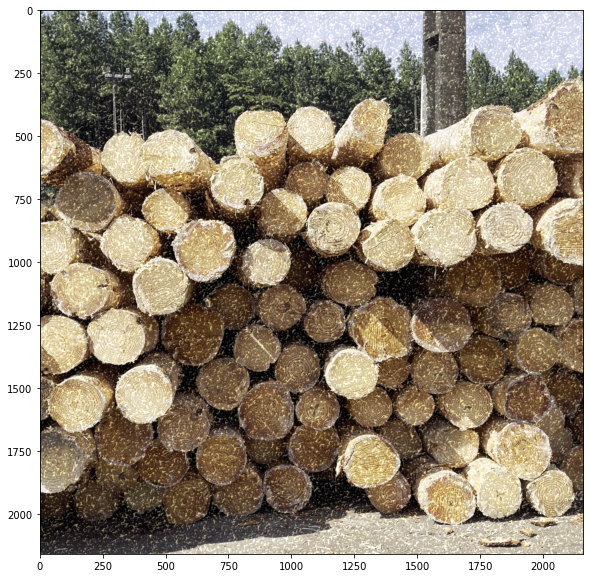

In [63]:
change      = Change()  
transformed = change.apply(img,bboxes)
    
plt.figure(figsize = (20,10))
plt.imshow(transformed["image"])

In [151]:
class Noise:
    def __init__(self):

        self.noise_transform = A.Compose([

        A.OneOf([


            #A.ImageCompression (quality_lower=65, quality_upper=75, always_apply=False, p=0.99), 

            #A.ISONoise(color_shift=(0.2, 0.3), intensity=(0.1, 0.2), always_apply=False, p=0.99), 

            #A.MultiplicativeNoise (multiplier=(0.7, 1.3), per_channel=True, elementwise=False, always_apply=True, p=0.99),

            A.Sharpen(alpha=(0.2, 0.25), lightness=(2, 4), always_apply=True, p=0.99),
            
            A.RGBShift(r_shift_limit=130, g_shift_limit=130, b_shift_limit=130, always_apply=True, p=0.99)

            ], p=1)

        ],bbox_params=A.BboxParams(format='pascal_voc', label_fields=[]))
        
    def apply(self,img,bboxes):
        
        return self.noise_transform(image=img, bboxes=bboxes) 


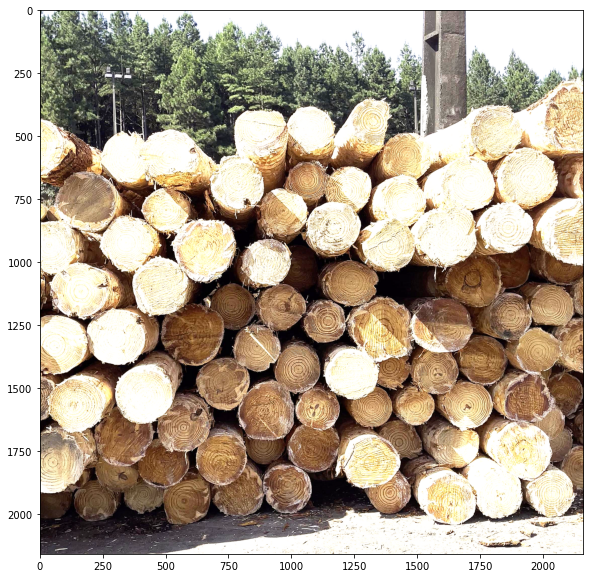

In [173]:
noise       = Noise()
transformed = noise.apply(img,bboxes)

plt.figure(figsize = (20,10))
plt.imshow(transformed["image"])

In [313]:
class Color:
    def __init__(self):
        
        self.color_transform = A.Compose([

        A.OneOf([


            #A.HueSaturationValue (hue_shift_limit=130, sat_shift_limit=140, val_shift_limit=30, always_apply=False, p=0.99),

            #A.RandomBrightnessContrast (brightness_limit=0.3, contrast_limit=0.05, brightness_by_max=True, always_apply=True, p=0.99)

            A.RandomGamma (gamma_limit=(170, 280), eps=None, always_apply=True, p=0.99)

            


            ], p=1)

        ],bbox_params=A.BboxParams(format='pascal_voc', label_fields=[]))


    def apply(self,img,bboxes):
        
        return self.color_transform(image=img, bboxes=bboxes)
    

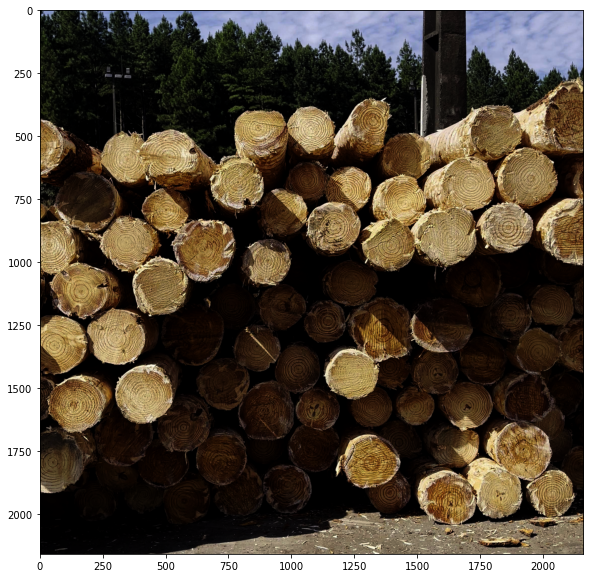

In [317]:
color = Color()

transformed = color.apply(img,bboxes)

plt.figure(figsize = (20,10))
plt.imshow(transformed["image"])

[1/i for i in range(2,6)]
## 4 rotações (original + 3)
## 4 crops    (original + 3)
## 3 transformações (original mais 3)



In [295]:
class Crop:
    def __init__(self,crop_proportions = None):
        self.iters = 0
        
        if crop_proportions is None:
            self.crop_proportions     = [1/i for i in range(2,6)]
            self.crop_proportions_4k  = [0.1, 0.15, 0.2, 0.24, 0.5]
            #[i for i in np.linspace( 0.1,0.8,6)]
            
    def apply(self,img,bboxes,previous_transforms):
        h,w,c  = img.shape
        self.crops = {}
        
        if h > 2000 and w > 2000:
            
            for proportion in self.crop_proportions_4k :
                
                visibility = 1 if proportion < 0.22 else 0.94 
                
                self.crops[str(round(proportion,3))] = A.Compose([
                    A.RandomCrop(width=int(w*proportion), height=int(h*proportion))
                ],bbox_params = A.BboxParams(format='pascal_voc', min_visibility=visibility, label_fields=[]))
        else:  
            for proportion in self.crop_proportions:
                
                visibility = 1 if proportion < 0.22 else 0.94 
                
                self.crops[str(round(proportion,3))] = A.Compose([
                    A.RandomCrop(width=int(w*proportion), height=int(h*proportion))
                ],bbox_params = A.BboxParams(format='pascal_voc', min_visibility=visibility, label_fields=[]))
        
        
        transformations = {}
        
        for proportion,crop in self.crops.items():

            croped = crop(image=img, bboxes=bboxes)
            
            
            tries = 0
            while len(croped["bboxes"])<3 and tries <= 200:
                croped = crop(image=img, bboxes=bboxes)
                tries+=1
                #print(len(croped["bboxes"]),"tries ",tries)
            
            if tries==201:
                print("crop tries exceed 200")
                continue
            #print(len(croped["bboxes"]))
                
            transformations[previous_transforms+"+crop:v"+str(self.iters)+"-p"+str(proportion)] = {"image":croped["image"],"bboxes":croped["bboxes"]}
                
            self.iters+=1
            
        return transformations
            

In [318]:
class Rotations:
    def __init__(self):
        
        self.vertical = A.Compose([

            A.VerticalFlip(p=1)

        ],bbox_params = A.BboxParams(format='pascal_voc', min_visibility=0.87, label_fields=[]))

        self.horizontal = A.Compose([

            A.HorizontalFlip(p=1)

        ],bbox_params = A.BboxParams(format='pascal_voc', min_visibility=0.87, label_fields=[]))


        self.vertical_horizontal = A.Compose([

            A.VerticalFlip(p=1),
            A.HorizontalFlip(p=1)

        ],bbox_params = A.BboxParams(format='pascal_voc', min_visibility=0.87, label_fields=[]))

    def apply(self,img,bboxes,root):
        
        transformations = {}
        
        print("TOTAL LABELS:",np.array(bboxes).shape)
        
        transformations[root+"_RAW"] = {"image":img.copy(),"bboxes":np.array(bboxes).astype(int).tolist()}
        
        #vertical_fliped    = self.vertical(image=img, bboxes=bboxes)
        #transformations[root+"_vertical_fliped"] = {"image":vertical_fliped["image"],"bboxes":np.array(vertical_fliped["bboxes"]).astype(int).tolist()}
        
        #vertical_fliped    = self.horizontal(image=img, bboxes=bboxes)
        #transformations[root+"_horizontal_fliped"] = {"image":vertical_fliped["image"], "bboxes":np.array(vertical_fliped["bboxes"]).astype(int).tolist()}
        
        vertical_fliped    = self.vertical_horizontal(image=img, bboxes=bboxes)
        transformations[root+"_vertical_horizontal_fliped"] = {"image":vertical_fliped["image"],"bboxes":np.array(vertical_fliped["bboxes"]).astype(int).tolist()}
        
        return transformations



In [113]:


img    = cv2.imread("realCampo/8.jpg")[:,:,::-1]
data   = read_json("realCampo/8.json")
labels = parse_labelme(data,img)
bboxes = pixel_to_proportion(img,labels)


TOTAL LABELS: (66, 4)


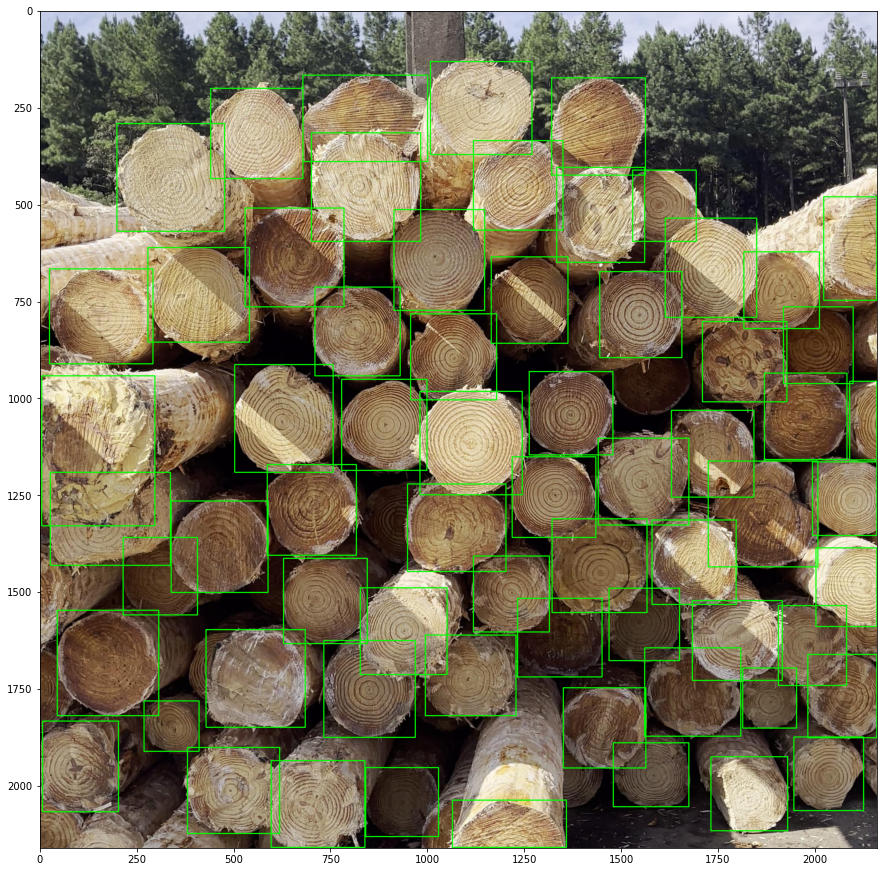

In [319]:
root   = "realCampo/8.json"
img    = cv2.imread("realCampo/8.jpg")[:,:,::-1]
data   = read_json("realCampo/8.json")
labels = parse_labelme(data,img)
bboxes = pixel_to_proportion(img,labels)

img           = draw_labels(labels,img,True)
augmentations = {}
rotations     = Rotations()
crop          = Crop()
rotated       = rotations.apply(img,labels,root)


TOTAL LABELS: (134, 4)
crop tries exceed 200
Eucalipto/6.json_RAW
(3000, 4000, 3)
(3000, 4000, 3)
(3000, 4000, 3)
(3000, 4000, 3)


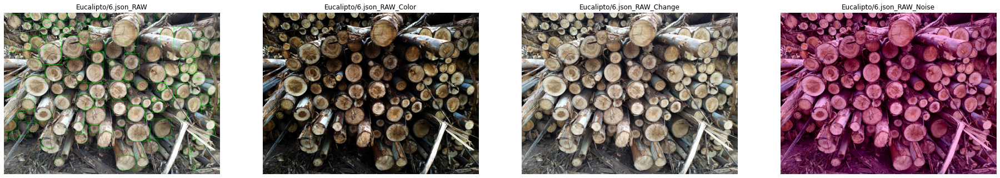

Eucalipto/6.json_vertical_horizontal_fliped
(3000, 4000, 3)
(3000, 4000, 3)
(3000, 4000, 3)
(3000, 4000, 3)


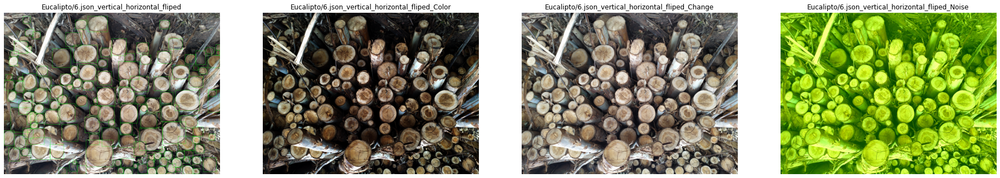

Eucalipto/6.json_RAW+crop:v0-p0.15
(450, 600, 3)
(450, 600, 3)
(450, 600, 3)
(450, 600, 3)


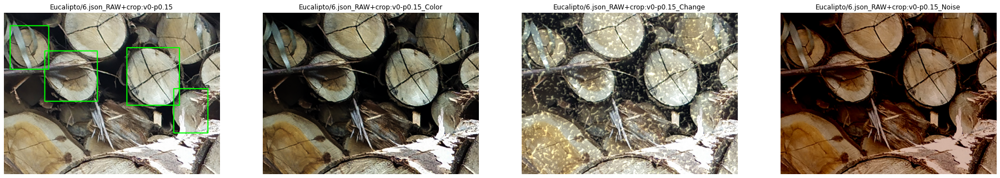

Eucalipto/6.json_RAW+crop:v1-p0.2
(600, 800, 3)
(600, 800, 3)
(600, 800, 3)
(600, 800, 3)


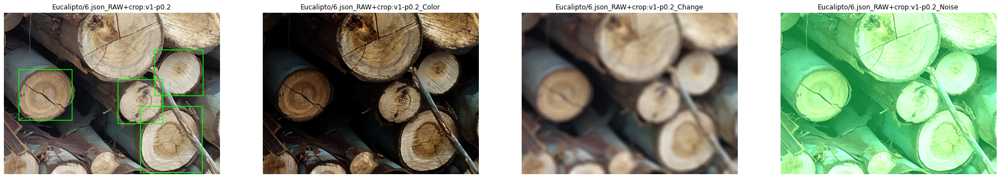

Eucalipto/6.json_RAW+crop:v2-p0.24
(720, 960, 3)
(720, 960, 3)
(720, 960, 3)
(720, 960, 3)


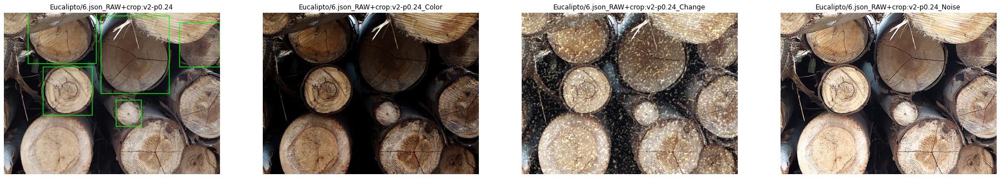

Eucalipto/6.json_RAW+crop:v3-p0.5
(1500, 2000, 3)
(1500, 2000, 3)
(1500, 2000, 3)
(1500, 2000, 3)


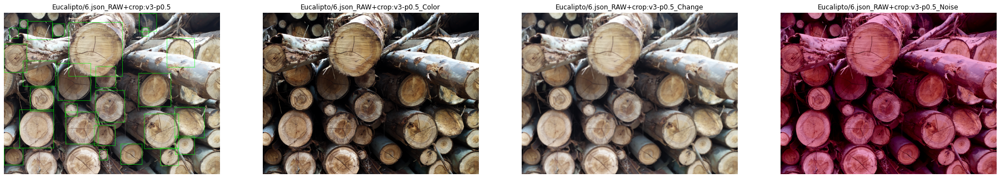

Eucalipto/6.json_vertical_horizontal_fliped+crop:v4-p0.1
(300, 400, 3)
(300, 400, 3)
(300, 400, 3)
(300, 400, 3)


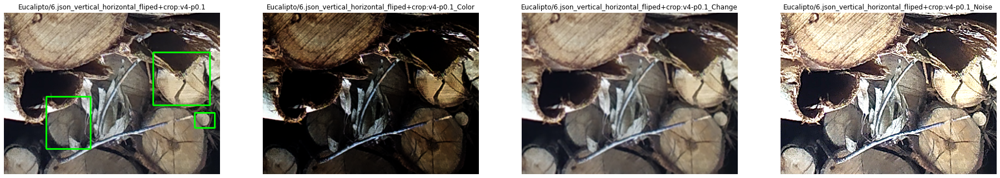

Eucalipto/6.json_vertical_horizontal_fliped+crop:v5-p0.15
(450, 600, 3)
(450, 600, 3)
(450, 600, 3)
(450, 600, 3)


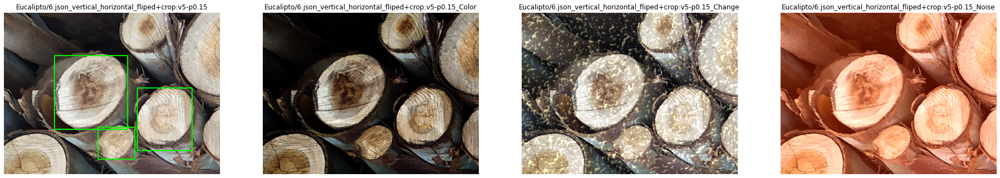

Eucalipto/6.json_vertical_horizontal_fliped+crop:v6-p0.2
(600, 800, 3)
(600, 800, 3)
(600, 800, 3)
(600, 800, 3)


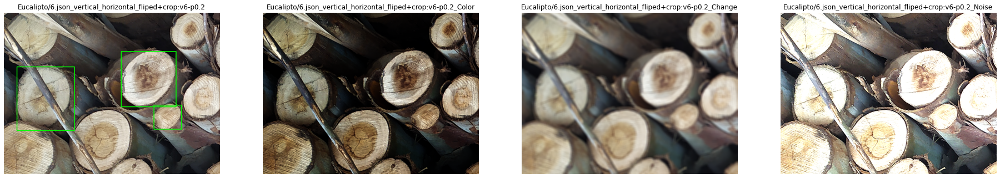

Eucalipto/6.json_vertical_horizontal_fliped+crop:v7-p0.24
(720, 960, 3)
(720, 960, 3)
(720, 960, 3)
(720, 960, 3)


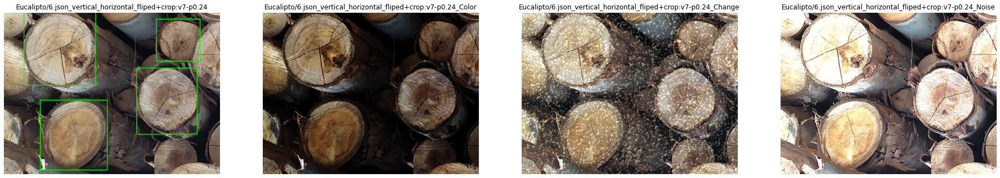

Eucalipto/6.json_vertical_horizontal_fliped+crop:v8-p0.5
(1500, 2000, 3)
(1500, 2000, 3)
(1500, 2000, 3)
(1500, 2000, 3)


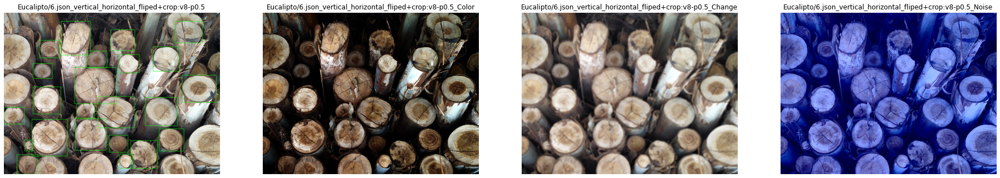

In [320]:
#img    = cv2.imread("realCampo/2.jpg")[:,:,::-1]
#data   = read_json("realCampo/2.json")
#labels = labelme_to_tf(data,img)
#bboxes = proportion_to_pixel(img,labels)

#img    = cv2.imread("CENIBRA/IMG_6272.JPG")[:,:,::-1]
#data   = read_json("CENIBRA/IMG_6272.json")

#img    = cv2.imread("CENIBRA/IMG_6338.JPG")[:,:,::-1]
#data   = read_json("CENIBRA/IMG_6338.json")

root   = "Eucalipto/6.json"

img    = cv2.imread("Eucalipto/6.jpg")[:,:,::-1]
data   = read_json("Eucalipto/6.json")

labels = parse_labelme(data,img)
bboxes = pixel_to_proportion(img,labels)


augmentations = {}
rotations     = Rotations()
crop          = Crop()
rotated       = rotations.apply(img,labels,root)
augmentations.update(rotated)


for key in rotated:   
    crop_transforms = crop.apply(rotated[key]["image"],rotated[key]["bboxes"],key)
    augmentations.update(crop_transforms)
    
augmentations.update(rotated) 

color = Color()

keys = list(augmentations.keys())

for key in keys:
    print(key)
    
    transformed_color  = color.apply(augmentations[key]["image"],augmentations[key]["bboxes"])
    transformed_change = change.apply(augmentations[key]["image"],augmentations[key]["bboxes"])
    transformed_noise  = noise.apply(augmentations[key]["image"],augmentations[key]["bboxes"])
    
    augmentations[key+"+color"]  = transformed_color
    augmentations[key+"+change"] = transformed_change
    augmentations[key+"+noise"]  = transformed_noise
    
    
    f, axarr = plt.subplots(1,4,figsize=(32,14))
    axarr[0].axis('off')
    axarr[1].axis('off')
    axarr[2].axis('off')
    axarr[3].axis('off')
    
    axarr[0].set_title(key)
    axarr[1].set_title(key+"_Color")
    axarr[2].set_title(key+"_Change")
    axarr[3].set_title(key+"_Noise")
    
    print(augmentations[key]["image"].shape)
    print(transformed_color["image"].shape)
    print( transformed_change["image"].shape)
    print(transformed_noise["image"].shape)
    
    draw_labels(augmentations[key]["bboxes"],  augmentations[key]["image"])
    draw_labels(transformed_color["bboxes"],   transformed_color["image"])
    draw_labels(transformed_change["bboxes"],  transformed_change["image"])
    draw_labels(transformed_noise["bboxes"],   transformed_noise["image"])
    
    #axarr[0].imshow(draw_labels(augmentations[key]["bboxes"],  augmentations[key]["image"]))
    #axarr[1].imshow(draw_labels(transformed_color["bboxes"],   transformed_color["image"]) )
    #axarr[2].imshow(draw_labels(transformed_change["bboxes"],  transformed_change["image"]))
    #axarr[3].imshow(draw_labels(transformed_noise["bboxes"],   transformed_noise["image"]) )
    
    axarr[0].imshow(draw_labels(augmentations[key]["bboxes"],  augmentations[key]["image"]))
    axarr[1].imshow(transformed_color["image"])
    axarr[2].imshow(transformed_change["image"])
    axarr[3].imshow(transformed_noise["image"])
    
    plt.show()

In [137]:
img     = cv2.imread("Eucalipto/6.jpg")[:,:,::-1]
h, w, c = img.shape
print(h/w)
int(h*0.2) ,int(w*0.2)

resized = cv2.resize(img, (int(h*0.2),int(w*0.2)), interpolation = cv2.INTER_AREA)
h, w, c = resized.shape

print(h/w)

0.75
1.3333333333333333


In [321]:
def convert_to_tf_lite(image,bboxes,image_path):
    '''
    (x1,y1) ---------------  (x2,y2)
      |                         |
      |                         |
      |                         |
      |                         |
    (x3,y3) ---------------- (x4,y4)

    '''

    bboxes  = bboxes
    h, w, c = image.shape
    
    tf_bounding_boxes = []
    for bb in bboxes:
        x_min, y_min, x_max, y_max = bb
        
        #            "x1",        "x2",          "x3",        "x4",
        #bb = [float(x_min), float(x_max), float(x_min), float(x_max), 
        #       "y1",              "y2",        "y3",          "y4"
        #      float(y_min), float(y_min), float(y_max), float(y_max)]
        
        
         #            "x1",        "y1",                "x2",        "y1",
        bb = [float(x_min), float(y_min),   float(x_max), float(y_min), 
        #           "x2",       "y2",          "y3",          "y4"
              float(x_max), float(y_max),   float(x_min), float(y_max)]

        bb = np.array(bb).astype(np.float16)
        
        bb[[1,3,5,7]] = (bb[[1,3,5,7]]/h).astype(np.float16)
        bb[[0,2,4,6]] = (bb[[0,2,4,6]]/w).astype(np.float16)
        
        
        tf_bounding_boxes.append(bb)
        
        #["split", "path", "log","x1","x2","x3","x4","y1","y2","y3","y4"]
    return np.array(tf_bounding_boxes)


In [322]:
def show_detections(augmentations,transformed_color,key):
    f, axarr = plt.subplots(1,4,figsize=(32,14))
    axarr[0].axis('off')
    axarr[1].axis('off')
    axarr[2].axis('off')
    axarr[3].axis('off')

    axarr[0].set_title(key)
    axarr[1].set_title(key+"_Color")
    axarr[2].set_title(key+"_Change")
    axarr[3].set_title(key+"_Noise")

    #draw_labels(augmentations[key]["bboxes"],  augmentations[key]["image"])
    #draw_labels(transformed_color["bboxes"],   transformed_color["image"])
    #draw_labels(transformed_change["bboxes"],  transformed_change["image"])
    #draw_labels(transformed_noise["bboxes"],   transformed_noise["image"])
    #axarr[0].imshow(draw_labels(augmentations[key]["bboxes"],  augmentations[key]["image"]))
    #axarr[1].imshow(draw_labels(transformed_color["bboxes"],   transformed_color["image"]) )
    #axarr[2].imshow(draw_labels(transformed_change["bboxes"],  transformed_change["image"]))
    #axarr[3].imshow(draw_labels(transformed_noise["bboxes"],   transformed_noise["image"]) )

    axarr[0].imshow(draw_labels(augmentations[key]["bboxes"],  augmentations[key]["image"]))
    axarr[1].imshow(draw_labels(transformed_color["bboxes"],   transformed_color["image"]))
    axarr[2].imshow(draw_labels(transformed_change["bboxes"],  transformed_change["image"]))
    axarr[3].imshow(draw_labels(transformed_noise["bboxes"],   transformed_noise["image"]))

    plt.show()

In [323]:
from tqdm import tqdm
import pandas as pd

def AugumentationPipeline(label_paths,show = False):
    
    image_path = label_paths.replace(".json",".jpg")
    root       = label_paths.replace(".json","").replace("/","_")
    
    img    = cv2.imread(image_path)
    data   = read_json(label_paths)
    labels = parse_labelme(data,img)
    bboxes = pixel_to_proportion(img,labels)

    augmentations = {}
    rotations     = Rotations()
    crop          = Crop()
    color         = Color()
    change        = Change()
    noise         = Noise()
    
    rotated       = rotations.apply(img,labels,root)
    
    print("applying rotations")
    augmentations.update(rotated)
    
    print("applying crop")
    
    for key in tqdm(rotated): 
        crop_transforms = crop.apply(rotated[key]["image"],rotated[key]["bboxes"],key)
        augmentations.update(crop_transforms)
    
    keys = list(augmentations.keys())
    
    print("applying change color and noise augumentations")
    
    for key in tqdm(keys):
        
        transformed_color  = color.apply(augmentations[key]["image"] ,augmentations[key]["bboxes"])
        transformed_change = change.apply(augmentations[key]["image"],augmentations[key]["bboxes"])
        transformed_noise  = noise.apply(augmentations[key]["image"] ,augmentations[key]["bboxes"])

        augmentations[key+"+color"]  = transformed_color
        augmentations[key+"+change"] = transformed_change
        augmentations[key+"+noise"]  = transformed_noise
    
        if show:
            show_detections(augmentations,transformed_color,key)
            
    save_path = "augumentations/"+label_paths.replace(".json","").split("/")[0]
    
    if not os.path.exists(save_path):
        os.mkdir(save_path)
        
    df_dict = {
        "split": [],
        "path":  [],
        "log":   [],
        "x1":    [],
        "x2":    [],
        "x3":    [],
        "x4":    [],
        "y1":    [],
        "y2":    [],
        "y3":    [],
        "y4":    []
    } 
    
    print("saving images and labels")
    
    prob = np.random.rand()
    
    if prob < 0.7:
        split = "TRAIN"   
    elif prob < 0.9:
        split = "TEST" 
    else: 
        split = "VALIDATION"
    
    for key in tqdm(list(augmentations.keys())):
        
        if len(augmentations[key]["bboxes"])>300: 
            print("too many labels in image",len(augmentations[key]["bboxes"]))
            continue
        
        image_path = save_path + "/" + key+ ".jpg"
        cv2.imwrite(image_path, augmentations[key]["image"])
        
        h,w,c      = augmentations[key]["image"].shape
        tf_lite_bb = convert_to_tf_lite(augmentations[key]["image"],augmentations[key]["bboxes"],image_path)
        
        for bb in tf_lite_bb:
            #print(bb)
            df_dict["split"].append(split)
            df_dict["path"].append(image_path)
            df_dict["log"].append("log") 
            df_dict["x1"].append(bb[0])  
            df_dict["x2"].append(bb[1])   
            df_dict["x3"].append(bb[2])   
            df_dict["x4"].append(bb[3])   
            df_dict["y1"].append(bb[4])   
            df_dict["y2"].append(bb[5])   
            df_dict["y3"].append(bb[6])   
            df_dict["y4"].append(bb[7]) 
        
    return pd.DataFrame(df_dict)   
        

In [324]:
import os 
from random import shuffle

def generate_all_label_paths():
    
    folders =   ['Eucalipto',
                 'oldPinus',
                 'CENIBRA',
                 'realCampo',
                 'Pinus']

    label_paths = []

    for folder in folders:
        files = os.listdir(folder)
        for file in files:
            if ".json" in file:
                label_paths.append(folder+"/"+file)

    for label in label_paths:
        image_path = label.replace(".json",".jpg")
        
    return label_paths

labels = generate_all_label_paths()

shuffle(labels)

len(labels)

119

In [325]:
df = None

for i,label in enumerate(labels):
    try:
        print("Augumenting image:",i,"out of", len(labels),"completed",round(i/len(labels)*100,2),"%", "path",label)
        if df is None:
            df = AugumentationPipeline(label,show = False)

        else:
            df2 = AugumentationPipeline(label,show = False)
            df = pd.concat([df,df2])

        df.to_csv("whole.csv",header=False, index=False)
    except Exception as e:
        print(e)



Augumenting image: 0 out of 119 completed 0.0 % path Pinus/2.json
TOTAL LABELS: (455, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 26.74it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  6.24it/s]


saving images and labels


 25%|██████████▌                               | 12/48 [00:00<00:00, 116.44it/s]

too many labels in image 455
too many labels in image 455
too many labels in image 455
too many labels in image 455
too many labels in image 455
too many labels in image 455
too many labels in image 455
too many labels in image 455


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 114.72it/s]


Augumenting image: 1 out of 119 completed 0.84 % path CENIBRA/IMG_6318.json
TOTAL LABELS: (227, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  5.83it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:00<00:00, 17.35it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 34.78it/s]


Augumenting image: 2 out of 119 completed 1.68 % path CENIBRA/IMG_6462.json
TOTAL LABELS: (0,)
applying rotations
applying crop


  0%|                                                     | 0/2 [00:00<?, ?it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  5.53it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  4.76it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 13.24it/s]


saving images and labels


100%|█████████████████████████████████████████████| 8/8 [00:00<00:00,  8.27it/s]


Augumenting image: 3 out of 119 completed 2.52 % path oldPinus/1.json
TOTAL LABELS: (19, 4)
applying rotations
applying crop


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  3.92it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  3.84it/s]


applying change color and noise augumentations


100%|█████████████████████████████████████████████| 4/4 [00:01<00:00,  2.13it/s]


saving images and labels


100%|███████████████████████████████████████████| 16/16 [00:01<00:00, 12.10it/s]


Augumenting image: 4 out of 119 completed 3.36 % path oldPinus/100.json
TOTAL LABELS: (21, 4)
applying rotations
applying crop


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  4.78it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  4.29it/s]


crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 6/6 [00:01<00:00,  3.07it/s]


saving images and labels


100%|███████████████████████████████████████████| 24/24 [00:01<00:00, 18.70it/s]


Augumenting image: 5 out of 119 completed 4.2 % path Pinus/79.json
TOTAL LABELS: (469, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 27.57it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:02<00:00,  4.21it/s]


saving images and labels


 25%|██████████▌                               | 12/48 [00:00<00:00, 114.04it/s]

too many labels in image 469
too many labels in image 469
too many labels in image 469
too many labels in image 469
too many labels in image 469
too many labels in image 469
too many labels in image 469
too many labels in image 469


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 114.50it/s]


Augumenting image: 6 out of 119 completed 5.04 % path CENIBRA/IMG_6396.json
TOTAL LABELS: (221, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  9.52it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  6.68it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 34.74it/s]


Augumenting image: 7 out of 119 completed 5.88 % path Eucalipto/7.json
TOTAL LABELS: (197, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 11.43it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  7.26it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 34.40it/s]


Augumenting image: 8 out of 119 completed 6.72 % path CENIBRA/IMG_6326.json
TOTAL LABELS: (305, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 27.40it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  8.27it/s]


saving images and labels


 44%|██████████████████▍                       | 21/48 [00:00<00:00, 207.69it/s]

too many labels in image 305
too many labels in image 305
too many labels in image 305
too many labels in image 305
too many labels in image 305
too many labels in image 305
too many labels in image 305
too many labels in image 305


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 126.11it/s]


Augumenting image: 9 out of 119 completed 7.56 % path CENIBRA/IMG_6327.json
TOTAL LABELS: (295, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 29.91it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:00<00:00, 18.68it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 35.56it/s]


Augumenting image: 10 out of 119 completed 8.4 % path CENIBRA/IMG_6330.json
TOTAL LABELS: (413, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 33.76it/s]

applying change color and noise augumentations



100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  7.55it/s]


saving images and labels


 40%|████████████████▋                         | 19/48 [00:00<00:00, 188.82it/s]

too many labels in image 413
too many labels in image 413
too many labels in image 413
too many labels in image 413
too many labels in image 413
too many labels in image 413
too many labels in image 413
too many labels in image 413


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 123.93it/s]


Augumenting image: 11 out of 119 completed 9.24 % path CENIBRA/IMG_6290.json
TOTAL LABELS: (217, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 11.66it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  8.17it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 32.76it/s]


Augumenting image: 12 out of 119 completed 10.08 % path CENIBRA/IMG_6447.json
TOTAL LABELS: (109, 4)
applying rotations
applying crop


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  3.40it/s]

crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  3.17it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|███████████████████████████████████████████| 10/10 [00:02<00:00,  3.48it/s]


saving images and labels


100%|███████████████████████████████████████████| 40/40 [00:01<00:00, 27.47it/s]


Augumenting image: 13 out of 119 completed 10.92 % path CENIBRA/IMG_6281.json
TOTAL LABELS: (215, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  2.77it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|███████████████████████████████████████████| 11/11 [00:00<00:00, 19.19it/s]


saving images and labels


100%|███████████████████████████████████████████| 44/44 [00:01<00:00, 31.52it/s]


Augumenting image: 14 out of 119 completed 11.76 % path CENIBRA/IMG_6273.json
TOTAL LABELS: (121, 4)
applying rotations
applying crop


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  2.31it/s]

crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:01<00:00,  1.93it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 9/9 [00:01<00:00,  5.03it/s]


saving images and labels


100%|███████████████████████████████████████████| 36/36 [00:01<00:00, 25.23it/s]


Augumenting image: 15 out of 119 completed 12.61 % path CENIBRA/IMG_6740.json
TOTAL LABELS: (55, 4)
applying rotations
applying crop


  0%|                                                     | 0/2 [00:00<?, ?it/s]

crop tries exceed 200
crop tries exceed 200


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  2.16it/s]

crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  2.19it/s]


crop tries exceed 200
crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 6/6 [00:01<00:00,  3.59it/s]


saving images and labels


100%|███████████████████████████████████████████| 24/24 [00:01<00:00, 19.34it/s]


Augumenting image: 16 out of 119 completed 13.45 % path CENIBRA/IMG_6306.json
TOTAL LABELS: (212, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  3.07it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|███████████████████████████████████████████| 11/11 [00:02<00:00,  3.69it/s]


saving images and labels


100%|███████████████████████████████████████████| 44/44 [00:01<00:00, 31.95it/s]


Augumenting image: 17 out of 119 completed 14.29 % path oldPinus/10.json
TOTAL LABELS: (13, 4)
applying rotations
applying crop


  0%|                                                     | 0/2 [00:00<?, ?it/s]

crop tries exceed 200


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  4.65it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  4.41it/s]


crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 4/4 [00:00<00:00,  8.72it/s]


saving images and labels


100%|███████████████████████████████████████████| 16/16 [00:01<00:00, 12.72it/s]


Augumenting image: 18 out of 119 completed 15.13 % path oldPinus/104.json
TOTAL LABELS: (17, 4)
applying rotations
applying crop


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  4.26it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  4.24it/s]


crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 4/4 [00:00<00:00, 20.87it/s]


saving images and labels


100%|███████████████████████████████████████████| 16/16 [00:01<00:00, 13.02it/s]


Augumenting image: 19 out of 119 completed 15.97 % path CENIBRA/IMG_6289.json
TOTAL LABELS: (299, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 26.27it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  7.81it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 34.17it/s]


Augumenting image: 20 out of 119 completed 16.81 % path oldPinus/103.json
TOTAL LABELS: (19, 4)
applying rotations
applying crop


  0%|                                                     | 0/2 [00:00<?, ?it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  3.85it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  3.53it/s]


applying change color and noise augumentations


100%|█████████████████████████████████████████████| 4/4 [00:02<00:00,  1.44it/s]


saving images and labels


100%|███████████████████████████████████████████| 16/16 [00:01<00:00, 12.04it/s]


Augumenting image: 21 out of 119 completed 17.65 % path CENIBRA/IMG_6295.json
TOTAL LABELS: (316, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 11.90it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:02<00:00,  4.40it/s]


saving images and labels


 25%|██████████▌                               | 12/48 [00:00<00:00, 118.91it/s]

too many labels in image 316
too many labels in image 316
too many labels in image 316
too many labels in image 316
too many labels in image 316
too many labels in image 316
too many labels in image 316
too many labels in image 316


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 122.01it/s]


Augumenting image: 22 out of 119 completed 18.49 % path CENIBRA/IMG_6272.json
TOTAL LABELS: (192, 4)
applying rotations
applying crop


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  2.07it/s]

crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  2.04it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|███████████████████████████████████████████| 10/10 [00:01<00:00,  5.72it/s]


saving images and labels


100%|███████████████████████████████████████████| 40/40 [00:01<00:00, 27.92it/s]


Augumenting image: 23 out of 119 completed 19.33 % path CENIBRA/IMG_6300.json
TOTAL LABELS: (176, 4)
applying rotations
applying crop


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  2.14it/s]

crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  2.21it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|███████████████████████████████████████████| 10/10 [00:00<00:00, 17.04it/s]


saving images and labels


100%|███████████████████████████████████████████| 40/40 [00:01<00:00, 29.44it/s]


Augumenting image: 24 out of 119 completed 20.17 % path CENIBRA/IMG_6486.json
TOTAL LABELS: (95, 4)
applying rotations
applying crop


  0%|                                                     | 0/2 [00:00<?, ?it/s]

crop tries exceed 200


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  2.04it/s]

crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  2.03it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 8/8 [00:00<00:00, 25.31it/s]


saving images and labels


100%|███████████████████████████████████████████| 32/32 [00:01<00:00, 22.94it/s]


Augumenting image: 25 out of 119 completed 21.01 % path CENIBRA/IMG_6429.json
TOTAL LABELS: (78, 4)
applying rotations
applying crop


  0%|                                                     | 0/2 [00:00<?, ?it/s]

crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  2.75it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 9/9 [00:01<00:00,  4.90it/s]


saving images and labels


100%|███████████████████████████████████████████| 36/36 [00:01<00:00, 25.70it/s]


Augumenting image: 26 out of 119 completed 21.85 % path Eucalipto/77.json
TOTAL LABELS: (337, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 17.70it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:02<00:00,  4.33it/s]


saving images and labels


 25%|██████████▌                               | 12/48 [00:00<00:00, 116.61it/s]

too many labels in image 337
too many labels in image 337
too many labels in image 337
too many labels in image 337
too many labels in image 337
too many labels in image 337
too many labels in image 337
too many labels in image 337


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 118.22it/s]


Augumenting image: 27 out of 119 completed 22.69 % path CENIBRA/IMG_6320.json
TOTAL LABELS: (320, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 28.25it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  7.39it/s]


saving images and labels


 44%|██████████████████▍                       | 21/48 [00:00<00:00, 207.53it/s]

too many labels in image 320
too many labels in image 320
too many labels in image 320
too many labels in image 320
too many labels in image 320
too many labels in image 320
too many labels in image 320
too many labels in image 320


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 122.81it/s]


Augumenting image: 28 out of 119 completed 23.53 % path CENIBRA/IMG_6276.json
TOTAL LABELS: (309, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 31.11it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  6.17it/s]


saving images and labels


 25%|██████████▌                               | 12/48 [00:00<00:00, 117.71it/s]

too many labels in image 309
too many labels in image 309
too many labels in image 309
too many labels in image 309
too many labels in image 309
too many labels in image 309
too many labels in image 309
too many labels in image 309


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 115.62it/s]


Augumenting image: 29 out of 119 completed 24.37 % path CENIBRA/IMG_6302.json
TOTAL LABELS: (216, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 14.37it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  7.26it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 32.92it/s]


Augumenting image: 30 out of 119 completed 25.21 % path CENIBRA/IMG_6440.json
TOTAL LABELS: (275, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  8.79it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  6.99it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 35.10it/s]


Augumenting image: 31 out of 119 completed 26.05 % path Eucalipto/1.json
TOTAL LABELS: (680, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 20.44it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  6.45it/s]


saving images and labels


 25%|██████████▌                               | 12/48 [00:00<00:00, 118.02it/s]

too many labels in image 680
too many labels in image 680
too many labels in image 680
too many labels in image 680
too many labels in image 680
too many labels in image 680
too many labels in image 680
too many labels in image 680


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 118.96it/s]


Augumenting image: 32 out of 119 completed 26.89 % path CENIBRA/IMG_6329.json
TOTAL LABELS: (377, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 33.53it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:03<00:00,  3.85it/s]


saving images and labels


 25%|██████████▌                               | 12/48 [00:00<00:00, 119.50it/s]

too many labels in image 377
too many labels in image 377
too many labels in image 377
too many labels in image 377
too many labels in image 377
too many labels in image 377
too many labels in image 377
too many labels in image 377


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 116.94it/s]


Augumenting image: 33 out of 119 completed 27.73 % path CENIBRA/IMG_6448.json
TOTAL LABELS: (89, 4)
applying rotations
applying crop


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  4.12it/s]

crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  4.03it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|███████████████████████████████████████████| 10/10 [00:02<00:00,  3.41it/s]


saving images and labels


100%|███████████████████████████████████████████| 40/40 [00:01<00:00, 27.15it/s]


Augumenting image: 34 out of 119 completed 28.57 % path CENIBRA/IMG_6279.json
TOTAL LABELS: (337, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 14.23it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:00<00:00, 34.75it/s]


saving images and labels


 25%|██████████▌                               | 12/48 [00:00<00:00, 116.32it/s]

too many labels in image 337
too many labels in image 337
too many labels in image 337
too many labels in image 337
too many labels in image 337
too many labels in image 337
too many labels in image 337
too many labels in image 337


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 121.36it/s]


Augumenting image: 35 out of 119 completed 29.41 % path CENIBRA/IMG_6303.json
TOTAL LABELS: (287, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 10.86it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:02<00:00,  5.55it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 32.94it/s]


Augumenting image: 36 out of 119 completed 30.25 % path Pinus/1.json
TOTAL LABELS: (680, 4)
y_max is less than or equal to y_min for bbox (0.418125, 1.0, 0.4375, 1.0).
Augumenting image: 37 out of 119 completed 31.09 % path Pinus/52.json
TOTAL LABELS: (216, 4)
y_max is less than or equal to y_min for bbox (0.01171875, 1.0, 0.0859375, 1.0).
Augumenting image: 38 out of 119 completed 31.93 % path CENIBRA/IMG_6317.json
TOTAL LABELS: (229, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 32.14it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:00<00:00, 13.60it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 37.24it/s]


Augumenting image: 39 out of 119 completed 32.77 % path CENIBRA/IMG_6311.json
TOTAL LABELS: (176, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  5.69it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:00<00:00, 12.64it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 36.15it/s]


Augumenting image: 40 out of 119 completed 33.61 % path Eucalipto/73.json
TOTAL LABELS: (556, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 25.64it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:02<00:00,  4.03it/s]


saving images and labels


 40%|████████████████▋                         | 19/48 [00:00<00:00, 189.41it/s]

too many labels in image 556
too many labels in image 556
too many labels in image 556
too many labels in image 556
too many labels in image 556
too many labels in image 556
too many labels in image 556
too many labels in image 556


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 121.23it/s]


Augumenting image: 41 out of 119 completed 34.45 % path oldPinus/102.json
TOTAL LABELS: (20, 4)
applying rotations
applying crop


  0%|                                                     | 0/2 [00:00<?, ?it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  3.82it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  4.26it/s]


applying change color and noise augumentations


100%|█████████████████████████████████████████████| 5/5 [00:02<00:00,  1.78it/s]


saving images and labels


100%|███████████████████████████████████████████| 20/20 [00:01<00:00, 14.92it/s]


Augumenting image: 42 out of 119 completed 35.29 % path CENIBRA/IMG_6292.json
TOTAL LABELS: (62, 4)
applying rotations
applying crop


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  2.93it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  2.38it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 7/7 [00:02<00:00,  2.40it/s]


saving images and labels


100%|███████████████████████████████████████████| 28/28 [00:01<00:00, 19.47it/s]


Augumenting image: 43 out of 119 completed 36.13 % path realCampo/7.json
TOTAL LABELS: (81, 4)
applying rotations
applying crop


  0%|                                                     | 0/2 [00:00<?, ?it/s]

crop tries exceed 200
crop tries exceed 200


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  2.31it/s]

crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  2.36it/s]


applying change color and noise augumentations


100%|█████████████████████████████████████████████| 8/8 [00:00<00:00, 12.57it/s]


saving images and labels


100%|███████████████████████████████████████████| 32/32 [00:00<00:00, 63.87it/s]


Augumenting image: 44 out of 119 completed 36.97 % path Eucalipto/82.json
TOTAL LABELS: (338, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 32.25it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:02<00:00,  4.38it/s]


saving images and labels


 25%|██████████▌                               | 12/48 [00:00<00:00, 111.84it/s]

too many labels in image 338
too many labels in image 338
too many labels in image 338
too many labels in image 338
too many labels in image 338
too many labels in image 338
too many labels in image 338
too many labels in image 338


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 116.92it/s]


Augumenting image: 45 out of 119 completed 37.82 % path CENIBRA/IMG_6310.json
TOTAL LABELS: (218, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 10.87it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:00<00:00, 14.24it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 34.51it/s]


Augumenting image: 46 out of 119 completed 38.66 % path CENIBRA/IMG_6293.json
TOTAL LABELS: (61, 4)
applying rotations
applying crop


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  4.30it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  2.76it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 8/8 [00:01<00:00,  4.53it/s]


saving images and labels


100%|███████████████████████████████████████████| 32/32 [00:01<00:00, 22.83it/s]


Augumenting image: 47 out of 119 completed 39.5 % path Eucalipto/79.json
TOTAL LABELS: (469, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 27.72it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:00<00:00, 17.99it/s]


saving images and labels


 25%|██████████▌                               | 12/48 [00:00<00:00, 116.42it/s]

too many labels in image 469
too many labels in image 469
too many labels in image 469
too many labels in image 469
too many labels in image 469
too many labels in image 469
too many labels in image 469
too many labels in image 469


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 116.90it/s]


Augumenting image: 48 out of 119 completed 40.34 % path CENIBRA/IMG_6282.json
TOTAL LABELS: (164, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  3.55it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|███████████████████████████████████████████| 11/11 [00:01<00:00,  6.19it/s]


saving images and labels


100%|███████████████████████████████████████████| 44/44 [00:01<00:00, 30.22it/s]


Augumenting image: 49 out of 119 completed 41.18 % path CENIBRA/IMG_6319.json
TOTAL LABELS: (200, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 18.60it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:02<00:00,  5.71it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 33.94it/s]


Augumenting image: 50 out of 119 completed 42.02 % path CENIBRA/IMG_6410.json
TOTAL LABELS: (104, 4)
applying rotations
applying crop


  0%|                                                     | 0/2 [00:00<?, ?it/s]

crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  2.19it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|███████████████████████████████████████████| 10/10 [00:01<00:00,  5.78it/s]


saving images and labels


100%|███████████████████████████████████████████| 40/40 [00:01<00:00, 27.78it/s]


Augumenting image: 51 out of 119 completed 42.86 % path CENIBRA/IMG_6309.json
TOTAL LABELS: (205, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 23.82it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:02<00:00,  5.88it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 35.33it/s]


Augumenting image: 52 out of 119 completed 43.7 % path Eucalipto/52.json
TOTAL LABELS: (216, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 20.88it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:00<00:00, 18.16it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 33.93it/s]


Augumenting image: 53 out of 119 completed 44.54 % path CENIBRA/IMG_6304.json
TOTAL LABELS: (232, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  2.46it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|███████████████████████████████████████████| 11/11 [00:01<00:00,  7.32it/s]


saving images and labels


100%|███████████████████████████████████████████| 44/44 [00:01<00:00, 30.65it/s]


Augumenting image: 54 out of 119 completed 45.38 % path oldPinus/109.json
TOTAL LABELS: (39, 4)
applying rotations
applying crop


  0%|                                                     | 0/2 [00:00<?, ?it/s]

crop tries exceed 200
crop tries exceed 200


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  3.01it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  2.64it/s]


applying change color and noise augumentations


100%|█████████████████████████████████████████████| 6/6 [00:00<00:00, 10.21it/s]


saving images and labels


100%|███████████████████████████████████████████| 24/24 [00:01<00:00, 18.84it/s]


Augumenting image: 55 out of 119 completed 46.22 % path CENIBRA/IMG_6325.json
TOTAL LABELS: (340, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 36.33it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  6.73it/s]


saving images and labels


 42%|█████████████████▌                        | 20/48 [00:00<00:00, 199.73it/s]

too many labels in image 340
too many labels in image 340
too many labels in image 340
too many labels in image 340
too many labels in image 340
too many labels in image 340
too many labels in image 340
too many labels in image 340


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 123.72it/s]


Augumenting image: 56 out of 119 completed 47.06 % path CENIBRA/IMG_6316.json
TOTAL LABELS: (301, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 17.68it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:00<00:00, 33.55it/s]


saving images and labels


 25%|██████████▌                               | 12/48 [00:00<00:00, 117.77it/s]

too many labels in image 301
too many labels in image 301
too many labels in image 301
too many labels in image 301
too many labels in image 301
too many labels in image 301
too many labels in image 301
too many labels in image 301


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 120.73it/s]


Augumenting image: 57 out of 119 completed 47.9 % path Pinus/21.json
TOTAL LABELS: (204, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 24.80it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:00<00:00, 17.14it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 34.15it/s]


Augumenting image: 58 out of 119 completed 48.74 % path Eucalipto/44.json
TOTAL LABELS: (392, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 31.98it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:02<00:00,  5.64it/s]


saving images and labels


 40%|████████████████▋                         | 19/48 [00:00<00:00, 188.90it/s]

too many labels in image 392
too many labels in image 392
too many labels in image 392
too many labels in image 392
too many labels in image 392
too many labels in image 392
too many labels in image 392
too many labels in image 392


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 117.11it/s]


Augumenting image: 59 out of 119 completed 49.58 % path CENIBRA/IMG_6312.json
TOTAL LABELS: (301, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 28.52it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:02<00:00,  4.05it/s]


saving images and labels


 42%|█████████████████▌                        | 20/48 [00:00<00:00, 199.83it/s]

too many labels in image 301
too many labels in image 301
too many labels in image 301
too many labels in image 301
too many labels in image 301
too many labels in image 301
too many labels in image 301
too many labels in image 301


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 118.28it/s]


Augumenting image: 60 out of 119 completed 50.42 % path CENIBRA/IMG_6286.json
TOTAL LABELS: (342, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 31.90it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  8.18it/s]


saving images and labels


 40%|████████████████▋                         | 19/48 [00:00<00:00, 188.71it/s]

too many labels in image 342
too many labels in image 342
too many labels in image 342
too many labels in image 342
too many labels in image 342
too many labels in image 342
too many labels in image 342
too many labels in image 342


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 123.23it/s]


Augumenting image: 61 out of 119 completed 51.26 % path Eucalipto/18.json
TOTAL LABELS: (193, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 10.24it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  8.45it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 34.49it/s]


Augumenting image: 62 out of 119 completed 52.1 % path CENIBRA/IMG_6280.json
TOTAL LABELS: (235, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 10.28it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:03<00:00,  3.68it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 32.79it/s]


Augumenting image: 63 out of 119 completed 52.94 % path Eucalipto/4.json
TOTAL LABELS: (359, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 21.13it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  6.74it/s]


saving images and labels


 40%|████████████████▋                         | 19/48 [00:00<00:00, 188.16it/s]

too many labels in image 359
too many labels in image 359
too many labels in image 359
too many labels in image 359
too many labels in image 359
too many labels in image 359
too many labels in image 359
too many labels in image 359


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 121.32it/s]


Augumenting image: 64 out of 119 completed 53.78 % path CENIBRA/IMG_6314.json
TOTAL LABELS: (219, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  6.20it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  6.78it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 35.14it/s]


Augumenting image: 65 out of 119 completed 54.62 % path Eucalipto/25.json
TOTAL LABELS: (341, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 34.13it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:03<00:00,  3.69it/s]


saving images and labels


 42%|█████████████████▌                        | 20/48 [00:00<00:00, 198.39it/s]

too many labels in image 341
too many labels in image 341
too many labels in image 341
too many labels in image 341
too many labels in image 341
too many labels in image 341
too many labels in image 341
too many labels in image 341


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 120.83it/s]


Augumenting image: 66 out of 119 completed 55.46 % path CENIBRA/IMG_6305.json
TOTAL LABELS: (194, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 13.42it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:02<00:00,  5.67it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 34.11it/s]


Augumenting image: 67 out of 119 completed 56.3 % path CENIBRA/IMG_6284.json
TOTAL LABELS: (275, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  6.94it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  7.77it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 32.99it/s]


Augumenting image: 68 out of 119 completed 57.14 % path CENIBRA/IMG_6321.json
TOTAL LABELS: (361, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 41.27it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  7.52it/s]


saving images and labels


 40%|████████████████▋                         | 19/48 [00:00<00:00, 189.64it/s]

too many labels in image 361
too many labels in image 361
too many labels in image 361
too many labels in image 361
too many labels in image 361
too many labels in image 361
too many labels in image 361
too many labels in image 361


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 123.92it/s]


Augumenting image: 69 out of 119 completed 57.98 % path CENIBRA/IMG_6287.json
TOTAL LABELS: (323, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 17.78it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  6.79it/s]


saving images and labels


 42%|█████████████████▌                        | 20/48 [00:00<00:00, 199.77it/s]

too many labels in image 323
too many labels in image 323
too many labels in image 323
too many labels in image 323
too many labels in image 323
too many labels in image 323
too many labels in image 323
too many labels in image 323


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 121.51it/s]


Augumenting image: 70 out of 119 completed 58.82 % path CENIBRA/IMG_6328.json
TOTAL LABELS: (238, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 50.75it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  6.88it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 34.16it/s]


Augumenting image: 71 out of 119 completed 59.66 % path CENIBRA/IMG_6444.json
TOTAL LABELS: (117, 4)
applying rotations
applying crop


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  2.20it/s]

crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  2.33it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|███████████████████████████████████████████| 10/10 [00:01<00:00,  5.57it/s]


saving images and labels


100%|███████████████████████████████████████████| 40/40 [00:01<00:00, 29.54it/s]


Augumenting image: 72 out of 119 completed 60.5 % path CENIBRA/IMG_6461.json
TOTAL LABELS: (218, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 21.78it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  8.11it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 33.91it/s]


Augumenting image: 73 out of 119 completed 61.34 % path CENIBRA/IMG_6322.json
TOTAL LABELS: (343, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 38.91it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  7.48it/s]


saving images and labels


 42%|█████████████████▌                        | 20/48 [00:00<00:00, 197.49it/s]

too many labels in image 343
too many labels in image 343
too many labels in image 343
too many labels in image 343
too many labels in image 343
too many labels in image 343
too many labels in image 343
too many labels in image 343


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 123.89it/s]


Augumenting image: 74 out of 119 completed 62.18 % path CENIBRA/IMG_6275.json
TOTAL LABELS: (269, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  4.04it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:02<00:00,  4.09it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 32.02it/s]


Augumenting image: 75 out of 119 completed 63.03 % path Eucalipto/2.json
TOTAL LABELS: (455, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 33.26it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  7.31it/s]


saving images and labels


 25%|██████████▌                               | 12/48 [00:00<00:00, 118.58it/s]

too many labels in image 455
too many labels in image 455
too many labels in image 455
too many labels in image 455
too many labels in image 455
too many labels in image 455
too many labels in image 455
too many labels in image 455


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 121.25it/s]


Augumenting image: 76 out of 119 completed 63.87 % path CENIBRA/IMG_6296.json
TOTAL LABELS: (56, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  7.63it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|███████████████████████████████████████████| 11/11 [00:00<00:00, 19.38it/s]


saving images and labels


100%|███████████████████████████████████████████| 44/44 [00:01<00:00, 32.30it/s]


Augumenting image: 77 out of 119 completed 64.71 % path CENIBRA/IMG_6323.json
TOTAL LABELS: (313, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 28.81it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  7.74it/s]


saving images and labels


 44%|██████████████████▍                       | 21/48 [00:00<00:00, 208.84it/s]

too many labels in image 313
too many labels in image 313
too many labels in image 313
too many labels in image 313
too many labels in image 313
too many labels in image 313
too many labels in image 313
too many labels in image 313


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 126.35it/s]


Augumenting image: 78 out of 119 completed 65.55 % path CENIBRA/IMG_6422.json
TOTAL LABELS: (739, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  9.21it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  7.27it/s]


saving images and labels


 58%|████████████████████████▌                 | 28/48 [00:00<00:00, 275.37it/s]

too many labels in image 739
too many labels in image 739
too many labels in image 453
too many labels in image 739
too many labels in image 739
too many labels in image 739
too many labels in image 739
too many labels in image 739
too many labels in image 739


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 180.85it/s]


too many labels in image 453
too many labels in image 453
too many labels in image 453
Augumenting image: 79 out of 119 completed 66.39 % path CENIBRA/IMG_6298.json
TOTAL LABELS: (118, 4)
applying rotations
applying crop


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  3.31it/s]

crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  3.21it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|███████████████████████████████████████████| 10/10 [00:01<00:00,  7.00it/s]


saving images and labels


100%|███████████████████████████████████████████| 40/40 [00:01<00:00, 28.50it/s]


Augumenting image: 80 out of 119 completed 67.23 % path CENIBRA/IMG_6308.json
TOTAL LABELS: (164, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  4.59it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|███████████████████████████████████████████| 11/11 [00:01<00:00,  6.26it/s]


saving images and labels


100%|███████████████████████████████████████████| 44/44 [00:01<00:00, 32.23it/s]


Augumenting image: 81 out of 119 completed 68.07 % path CENIBRA/IMG_6301.json
TOTAL LABELS: (217, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:01<00:00,  1.98it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|███████████████████████████████████████████| 11/11 [00:01<00:00,  5.86it/s]


saving images and labels


100%|███████████████████████████████████████████| 44/44 [00:01<00:00, 30.88it/s]


Augumenting image: 82 out of 119 completed 68.91 % path Eucalipto/83.json
TOTAL LABELS: (289, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 37.17it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  6.48it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 33.48it/s]


Augumenting image: 83 out of 119 completed 69.75 % path oldPinus/107.json
TOTAL LABELS: (36, 4)
applying rotations
applying crop


  0%|                                                     | 0/2 [00:00<?, ?it/s]

crop tries exceed 200
crop tries exceed 200


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  2.42it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  2.40it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 5/5 [00:01<00:00,  3.74it/s]


saving images and labels


100%|███████████████████████████████████████████| 20/20 [00:01<00:00, 15.54it/s]


Augumenting image: 84 out of 119 completed 70.59 % path CENIBRA/IMG_6283.json
TOTAL LABELS: (233, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  6.08it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:02<00:00,  4.84it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 32.92it/s]


Augumenting image: 85 out of 119 completed 71.43 % path CENIBRA/IMG_6412.json
TOTAL LABELS: (4, 4)
applying rotations
applying crop


  0%|                                                     | 0/2 [00:00<?, ?it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  3.95it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  3.95it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 2/2 [00:02<00:00,  1.22s/it]


saving images and labels


100%|█████████████████████████████████████████████| 8/8 [00:01<00:00,  7.74it/s]


Augumenting image: 86 out of 119 completed 72.27 % path Eucalipto/10.json
TOTAL LABELS: (161, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 16.07it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  6.92it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 35.37it/s]


Augumenting image: 87 out of 119 completed 73.11 % path oldPinus/101.json
TOTAL LABELS: (22, 4)
applying rotations
applying crop


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  4.05it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  4.23it/s]


crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 6/6 [00:02<00:00,  2.06it/s]


saving images and labels


100%|███████████████████████████████████████████| 24/24 [00:01<00:00, 17.57it/s]


Augumenting image: 88 out of 119 completed 73.95 % path Eucalipto/3.json
TOTAL LABELS: (689, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 21.64it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:02<00:00,  5.60it/s]


saving images and labels


 25%|██████████▌                               | 12/48 [00:00<00:00, 119.37it/s]

too many labels in image 689
too many labels in image 689
too many labels in image 689
too many labels in image 689
too many labels in image 689
too many labels in image 689
too many labels in image 689
too many labels in image 689


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 115.40it/s]


Augumenting image: 89 out of 119 completed 74.79 % path oldPinus/11.json
TOTAL LABELS: (19, 4)
applying rotations
applying crop


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  7.28it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  6.56it/s]


applying change color and noise augumentations


100%|█████████████████████████████████████████████| 8/8 [00:00<00:00, 27.79it/s]


saving images and labels


100%|███████████████████████████████████████████| 32/32 [00:01<00:00, 24.05it/s]


Augumenting image: 90 out of 119 completed 75.63 % path CENIBRA/IMG_6294.json
TOTAL LABELS: (237, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  5.33it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:00<00:00, 12.61it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 33.62it/s]


Augumenting image: 91 out of 119 completed 76.47 % path Eucalipto/6.json
TOTAL LABELS: (134, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  4.46it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|███████████████████████████████████████████| 11/11 [00:02<00:00,  3.76it/s]


saving images and labels


100%|███████████████████████████████████████████| 44/44 [00:01<00:00, 30.69it/s]


Augumenting image: 92 out of 119 completed 77.31 % path Pinus/10.json
TOTAL LABELS: (161, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 12.07it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:02<00:00,  4.26it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 33.39it/s]


Augumenting image: 93 out of 119 completed 78.15 % path CENIBRA/IMG_6411.json
TOTAL LABELS: (9, 4)
applying rotations
applying crop


  0%|                                                     | 0/2 [00:00<?, ?it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  3.13it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  3.14it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 2/2 [00:01<00:00,  1.54it/s]


saving images and labels


100%|█████████████████████████████████████████████| 8/8 [00:01<00:00,  7.78it/s]


Augumenting image: 94 out of 119 completed 78.99 % path CENIBRA/IMG_6299.json
TOTAL LABELS: (152, 4)
applying rotations
applying crop


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  2.47it/s]

crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  2.50it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|███████████████████████████████████████████| 10/10 [00:02<00:00,  3.45it/s]


saving images and labels


100%|███████████████████████████████████████████| 40/40 [00:01<00:00, 28.11it/s]


Augumenting image: 95 out of 119 completed 79.83 % path CENIBRA/IMG_6291.json
TOTAL LABELS: (81, 4)
applying rotations
applying crop


  0%|                                                     | 0/2 [00:00<?, ?it/s]

crop tries exceed 200


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  2.28it/s]

crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  2.28it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 8/8 [00:02<00:00,  2.70it/s]


saving images and labels


100%|███████████████████████████████████████████| 32/32 [00:01<00:00, 22.39it/s]


Augumenting image: 96 out of 119 completed 80.67 % path CENIBRA/IMG_6424.json
TOTAL LABELS: (59, 4)
applying rotations
applying crop


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  4.35it/s]

crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  4.98it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|███████████████████████████████████████████| 10/10 [00:01<00:00,  5.58it/s]


saving images and labels


100%|███████████████████████████████████████████| 40/40 [00:01<00:00, 29.05it/s]


Augumenting image: 97 out of 119 completed 81.51 % path Pinus/7.json
TOTAL LABELS: (197, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 16.14it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:00<00:00, 19.42it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 35.47it/s]


Augumenting image: 98 out of 119 completed 82.35 % path realCampo/6.json
TOTAL LABELS: (83, 4)
applying rotations
applying crop


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  3.40it/s]

crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  3.16it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|███████████████████████████████████████████| 10/10 [00:00<00:00, 16.20it/s]


saving images and labels


100%|███████████████████████████████████████████| 40/40 [00:00<00:00, 79.86it/s]


Augumenting image: 99 out of 119 completed 83.19 % path CENIBRA/IMG_6297.json
TOTAL LABELS: (790, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 20.04it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  6.33it/s]


saving images and labels


 25%|██████████▌                               | 12/48 [00:00<00:00, 114.26it/s]

too many labels in image 790
too many labels in image 790
too many labels in image 790
too many labels in image 790
too many labels in image 790
too many labels in image 790
too many labels in image 790
too many labels in image 790


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 114.74it/s]


Augumenting image: 100 out of 119 completed 84.03 % path Pinus/6.json
TOTAL LABELS: (134, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  7.16it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  7.06it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 35.43it/s]


Augumenting image: 101 out of 119 completed 84.87 % path oldPinus/106.json
TOTAL LABELS: (28, 4)
applying rotations
applying crop


  0%|                                                     | 0/2 [00:00<?, ?it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  3.12it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  3.01it/s]


crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 5/5 [00:01<00:00,  3.12it/s]


saving images and labels


100%|███████████████████████████████████████████| 20/20 [00:01<00:00, 15.32it/s]


Augumenting image: 102 out of 119 completed 85.71 % path CENIBRA/IMG_6313.json
TOTAL LABELS: (237, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 39.78it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:03<00:00,  3.77it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 33.82it/s]


Augumenting image: 103 out of 119 completed 86.55 % path CENIBRA/IMG_6277.json
TOTAL LABELS: (249, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 34.43it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:00<00:00, 24.36it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 34.93it/s]


Augumenting image: 104 out of 119 completed 87.39 % path CENIBRA/IMG_6285.json
TOTAL LABELS: (285, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  6.82it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:02<00:00,  4.09it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 33.17it/s]


Augumenting image: 105 out of 119 completed 88.24 % path CENIBRA/IMG_6288.json
TOTAL LABELS: (345, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 10.89it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:02<00:00,  4.51it/s]


saving images and labels


 25%|██████████▌                               | 12/48 [00:00<00:00, 116.96it/s]

too many labels in image 345
too many labels in image 345
too many labels in image 345
too many labels in image 345
too many labels in image 345
too many labels in image 345
too many labels in image 345
too many labels in image 345


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 122.43it/s]


Augumenting image: 106 out of 119 completed 89.08 % path Pinus/4.json
TOTAL LABELS: (359, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 21.04it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  6.94it/s]


saving images and labels


 48%|████████████████████▏                     | 23/48 [00:00<00:00, 229.60it/s]

too many labels in image 359
too many labels in image 359
too many labels in image 359
too many labels in image 359
too many labels in image 359
too many labels in image 359
too many labels in image 359
too many labels in image 359


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 128.58it/s]


Augumenting image: 107 out of 119 completed 89.92 % path CENIBRA/IMG_6307.json
TOTAL LABELS: (215, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  7.81it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  7.32it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 35.18it/s]


Augumenting image: 108 out of 119 completed 90.76 % path realCampo/8.json
TOTAL LABELS: (66, 4)
applying rotations
applying crop


  0%|                                                     | 0/2 [00:00<?, ?it/s]

crop tries exceed 200
crop tries exceed 200


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  2.03it/s]

crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  2.03it/s]


crop tries exceed 200
crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 6/6 [00:00<00:00,  9.63it/s]


saving images and labels


100%|███████████████████████████████████████████| 24/24 [00:00<00:00, 49.32it/s]


Augumenting image: 109 out of 119 completed 91.6 % path CENIBRA/IMG_6338.json
TOTAL LABELS: (422, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 24.97it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  6.42it/s]


saving images and labels


 42%|█████████████████▌                        | 20/48 [00:00<00:00, 198.60it/s]

too many labels in image 422
too many labels in image 422
too many labels in image 422
too many labels in image 422
too many labels in image 422
too many labels in image 422
too many labels in image 422
too many labels in image 422


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 119.91it/s]


Augumenting image: 110 out of 119 completed 92.44 % path Pinus/3.json
TOTAL LABELS: (689, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 22.23it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:00<00:00, 13.12it/s]


saving images and labels


 44%|██████████████████▍                       | 21/48 [00:00<00:00, 208.30it/s]

too many labels in image 689
too many labels in image 689
too many labels in image 689
too many labels in image 689
too many labels in image 689
too many labels in image 689
too many labels in image 689
too many labels in image 689


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 118.98it/s]


Augumenting image: 111 out of 119 completed 93.28 % path CENIBRA/IMG_6274.json
TOTAL LABELS: (15, 4)
applying rotations
applying crop


  0%|                                                     | 0/2 [00:00<?, ?it/s]

crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  8.32it/s]


crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 8/8 [00:01<00:00,  5.60it/s]


saving images and labels


100%|███████████████████████████████████████████| 32/32 [00:01<00:00, 23.21it/s]


Augumenting image: 112 out of 119 completed 94.12 % path CENIBRA/IMG_6388.json
TOTAL LABELS: (254, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  3.73it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  6.85it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 34.06it/s]


Augumenting image: 113 out of 119 completed 94.96 % path CENIBRA/IMG_6324.json
TOTAL LABELS: (332, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 16.85it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:03<00:00,  3.99it/s]


saving images and labels


 44%|██████████████████▍                       | 21/48 [00:00<00:00, 207.83it/s]

too many labels in image 332
too many labels in image 332
too many labels in image 332
too many labels in image 332
too many labels in image 332
too many labels in image 332
too many labels in image 332
too many labels in image 332


100%|██████████████████████████████████████████| 48/48 [00:00<00:00, 122.08it/s]


Augumenting image: 114 out of 119 completed 95.8 % path CENIBRA/IMG_6278.json
TOTAL LABELS: (253, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  5.35it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  7.59it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 32.89it/s]


Augumenting image: 115 out of 119 completed 96.64 % path oldPinus/105.json
TOTAL LABELS: (16, 4)
applying rotations
applying crop


 50%|██████████████████████▌                      | 1/2 [00:00<00:00,  4.42it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  4.46it/s]


crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 4/4 [00:00<00:00,  8.44it/s]


saving images and labels


100%|███████████████████████████████████████████| 16/16 [00:01<00:00, 13.02it/s]


Augumenting image: 116 out of 119 completed 97.48 % path CENIBRA/IMG_6315.json
TOTAL LABELS: (227, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 20.77it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:01<00:00,  6.82it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 35.50it/s]


Augumenting image: 117 out of 119 completed 98.32 % path Eucalipto/21.json
TOTAL LABELS: (204, 4)
applying rotations
applying crop


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00, 20.57it/s]


applying change color and noise augumentations


100%|███████████████████████████████████████████| 12/12 [00:03<00:00,  3.93it/s]


saving images and labels


100%|███████████████████████████████████████████| 48/48 [00:01<00:00, 33.39it/s]


Augumenting image: 118 out of 119 completed 99.16 % path oldPinus/108.json
TOTAL LABELS: (27, 4)
applying rotations
applying crop


  0%|                                                     | 0/2 [00:00<?, ?it/s]

crop tries exceed 200
crop tries exceed 200
crop tries exceed 200


100%|█████████████████████████████████████████████| 2/2 [00:00<00:00,  3.64it/s]


crop tries exceed 200
crop tries exceed 200
crop tries exceed 200
applying change color and noise augumentations


100%|█████████████████████████████████████████████| 6/6 [00:01<00:00,  3.69it/s]


saving images and labels


100%|███████████████████████████████████████████| 24/24 [00:01<00:00, 18.18it/s]


In [130]:
df

,split,path,log,x1,x2,x3,x4,y1,y2,y3,y4
0,TRAIN,augumentations/CENIBRA/CENIBRA_IMG_6315_RAW.jpg,log,0.000000,0.159058,0.032257,0.159058,0.032257,0.203735,0.000000,0.203735
1,TRAIN,augumentations/CENIBRA/CENIBRA_IMG_6315_RAW.jpg,log,0.165894,0.125610,0.189941,0.125610,0.189941,0.146118,0.165894,0.146118
2,TRAIN,augumentations/CENIBRA/CENIBRA_IMG_6315_RAW.jpg,log,0.191772,0.134888,0.206055,0.134888,0.206055,0.147217,0.191772,0.147217
3,TRAIN,augumentations/CENIBRA/CENIBRA_IMG_6315_RAW.jpg,log,0.166382,0.166992,0.180786,0.166992,0.180786,0.190796,0.166382,0.190796
4,TRAIN,augumentations/CENIBRA/CENIBRA_IMG_6315_RAW.jpg,log,0.132690,0.166382,0.153809,0.166382,0.153809,0.184814,0.132690,0.184814
...,...,...,...,...,...,...,...,...,...,...,...
1303,TEST,augumentations/Eucalipto/Eucalipto_44_vertical...,log,0.013390,0.118408,0.038208,0.118408,0.038208,0.154053,0.013390,0.154053
1304,TEST,augumentations/Eucalipto/Eucalipto_44_vertical...,log,0.181519,0.609863,0.233154,0.609863,0.233154,0.671875,0.181519,0.671875
1305,TEST,augumentations/Eucalipto/Eucalipto_44_vertical...,log,0.075867,0.533203,0.160767,0.533203,0.160767,0.645996,0.075867,0.645996
1306,TEST,augumentations/Eucalipto/Eucalipto_44_vertical...,log,0.012894,0.482178,0.078857,0.482178,0.078857,0.572754,0.012894,0.572754


In [142]:
df.to_csv("whole.csv",header=False, index=False)

In [24]:
names = AugumentationPipeline(label_paths[0],show = False)

2
7
11
21
40
65
103
137
151
175
2
9
18
36
36
76
99
121
152
172
5
6
13
34
50
59
99
134
163
178
2
8
14
34
38
63
97
100
161
180


In [ ]:
A.VerticalFlip(p=0.5),
A.HorizontalFlip(p=0.5),

transform = A.Compose([

    #A.RandomCrop(width=int(w/i), height=int(h/i))

],bbox_params = A.BboxParams(format='pascal_voc', min_visibility=0.77, label_fields=[]))

In [119]:
4*4*4*80

5120

In [151]:
labels.shape,np.array(transformed_bboxes).shape

((69, 8), (18, 4))

(84, 20) (122, 65)
(75, 92) (108, 126)
(8, 104) (33, 127)
(33, 120) (75, 150)
(126, 39) (141, 54)
(54, 47) (86, 80)
(109, 94) (140, 122)
(31, 58) (58, 84)
(15, 74) (40, 96)
(26, 10) (49, 30)
(120, 57) (148, 81)
(109, 4) (137, 29)
(63, 0) (101, 32)
(81, 63) (108, 91)
(131, 82) (150, 101)
(47, 78) (78, 109)
(50, 20) (75, 46)
(5, 43) (36, 73)
(107, 77) (128, 96)


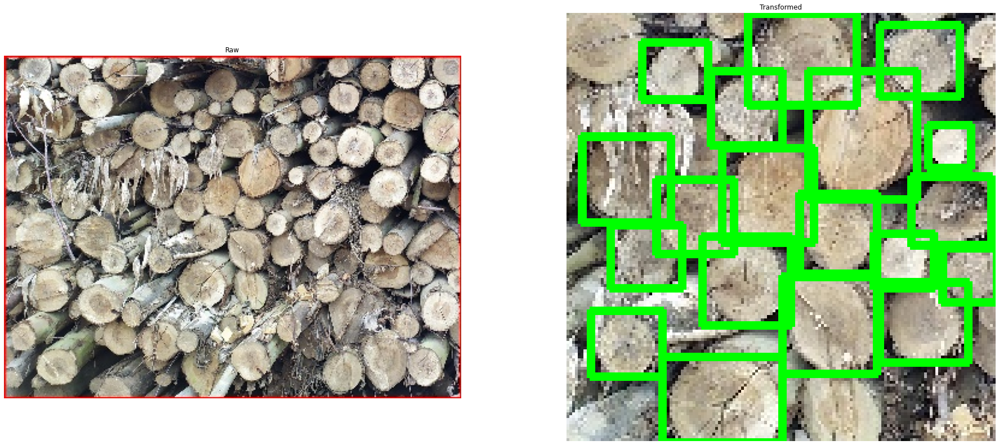

In [166]:
#img                  = draw_labels(labels,img)
transformed_draw_img = draw_labels(np.array(transformed_bboxes),transformed_img)

f, axarr = plt.subplots(1,2,figsize=(32,14))
axarr[0].axis('off')
axarr[1].axis('off')
axarr[0].set_title("Raw")
axarr[1].set_title("Transformed")
axarr[0].imshow(img[:,:,::-1])
axarr[1].imshow(transformed_draw_img[:,:,::-1])

In [150]:
transformed_bboxes

[(115.00000000000001, 28.0, 137.0, 46.0),
 (100.0, 39.0, 131.0, 68.0),
 (69.0, 11.0, 103.0, 44.0),
 (79.00000000000003, 104.0, 106.99999999999997, 131.0),
 (105.00000000000003, 115.00000000000001, 129.0, 137.0),
 (106.99999999999997, 1.0, 125.0, 13.0),
 (106.99999999999997, 93.0, 126.0, 109.0),
 (37.0, 76.0, 79.00000000000003, 114.0),
 (46.0, 113.0, 73.0, 141.0),
 (43.0, 22.0, 70.0, 49.0),
 (33.0, 51.00000000000001, 59.0, 74.0),
 (65.00000000000003, 38.0, 91.00000000000004, 59.0),
 (68.0, 60.0, 114.0, 103.0),
 (18.0, 118.0, 43.0, 140.0),
 (96.0, 103.0, 111.0, 116.0),
 (120.00000000000003, 96.0, 150.0, 121.0),
 (0.0, 83.0, 25.0, 107.0),
 (0.0, 24.0, 24.0, 50.0)]

FAZ AUGMENTATIONS DE FLIP, BLUR E BRIGHTNESS E SALVA FOTOS NA PASTA AUGMENTATION

In [ ]:

pastaDrive = '/content/drive/MyDrive/images_16.02.22/augmentation'



for image in images:
    split = image.split("/")
    nomePasta = split[5]
    nomeFoto = split[6]

    bboxes = []


    for row in trainRows:
    if image == row[1]:
        temp = []
        temp.append(float(row[3]))
        temp.append(float(row[4]))
        temp.append(float(row[7]))
        temp.append(float(row[8]))
        bboxes.append(temp)

    img = cv2.imread(image)


    transform = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.OneOf([
        A.Blur(p=0.3),
        A.MedianBlur(p=0.3),
        A.MotionBlur(p=0.3),
    ], p=0.8),
    A.OneOf([
        A.RandomBrightnessContrast(p=1.0),
    ], p=0.8),

    # A.ISONoise(p=1.0),
    # A.RandomRain(p=1.0, drop_length=27, blur_value=5, brightness_coefficient=0.7)
    # A.RandomSunFlare(p=1.0)
    # A.Perspective(p=1.0)
    ],bbox_params=A.BboxParams(format='albumentations', label_fields=[]))


    images_list = []
    bboxes_list = []

    for i in range(3):
        transformed = transform(image=img, bboxes=bboxes)
        transformed_img = transformed["image"]
        transformed_bboxes = transformed["bboxes"]

        images_list.append(transformed_img)
        bboxes_list.append(transformed_bboxes)


    photoCount = 1
    j = 0
    for imageT in images_list:
        nomeFotoT = pastaDrive + '/' + nomePasta + '/' + nomeFoto[:-4] + '_T' + str(photoCount) + '.jpg'
        cv2.imwrite(nomeFotoT, imageT)
        height = imageT.shape[0]
        width = imageT.shape[1]
        for bboxes in bboxes_list[j]:  
            x_min = bboxes[0]
            y_min = bboxes[1]
            x_max = bboxes[2]
            y_max = bboxes[3]

            ymin = int(max(1,(y_min * height)))
            xmin = int(max(1,(x_min * width)))
            ymax = int(min(height,(y_max * height)))
            xmax = int(min(width,(x_max * width)))

            data = ["TRAIN", nomeFotoT, 'log', x_min, y_min, x_max, y_min, x_max, y_max, x_min, y_max]

            allRows.append(data)

            cv2.rectangle(imageT, (xmin,ymin), (xmax,ymax), (10, 255, 0), 2)


    photoCount += 1
    j += 1
    # cv2_imshow(imageT)


SHUFFLE NO DATASET

In [ ]:
newUniqueRows = []
newRowsCount = []
newRows = []


for x in allRows:

    newRowsCount.append(x)

    linha = x[1]

    if not newUniqueRows:
        newUniqueRows.append(linha)

    elif newUniqueRows[-1] != linha:
        newUniqueRows.append(linha)


#shuffle
random.shuffle(newUniqueRows)


for index, i in enumerate(newUniqueRows):
    for j in newRowsCount:
        if i == j[1]:
            data = [j[0], j[1], j[2], j[3], j[4], j[5], j[6], j[7], j[8], j[9], j[10]]
            newRows.append(data)

SALVA CSV COM TODAS AS BOUNDING BOXES

In [ ]:
with open('/content/drive/MyDrive/CSVs/Modelo5_T.csv', 'w', newline='') as f:

    for data in newRows:

        writer = csv.writer(f)

        writer.writerow(data)